## Separação de Fontes de Áudio com Análise de Componentes Independentes (ICA)

*PASSO 1: Carregar os áudios*

In [65]:
import numpy as np
import matplotlib.pyplot as plt
import librosa  # biblioteca para processamento de áudio
from sklearn.decomposition import FastICA  # algoritmo de separação de sinais diferentes

# Carregar os arquivos de áudio 
# Assegure-se que eles tenham a mesma duração e taxa de amostragem
voz, sr_voz = librosa.load('audio_voz1.mp4', sr=None)  # retorna um vetor com os dados do áudio e a taxa de amostragem
piano, sr_piano = librosa.load('audio_piano1.mp4', sr=None)  # sr=None, sem reamostragem, amostragem original do áudio

# Verificar se as taxas de amostragem são iguais
if sr_voz != sr_piano:
    print("Taxas de amostragem diferentes, padronize os arquivos.")

# o ICA só funciona com a mesma taxa de amostragem

print(voz)
print(piano)

[ 3.0517578e-05  3.0517578e-05  0.0000000e+00 ... -4.5776367e-05
  1.5258789e-05  1.5258789e-05]
[-1.5258789e-05 -3.0517578e-05 -3.0517578e-05 ... -1.0681152e-04
 -7.6293945e-05 -6.1035156e-05]


/var/folders/jq/kc91dtkj57n7cvtqpfmgtntc0000gn/T/ipykernel_5302/398243181.py:8: UserWarning: PySoundFile failed. Trying audioread instead.
  voz, sr_voz = librosa.load('audio_voz1.mp4', sr=None)  # retorna um vetor com os dados do áudio e a taxa de amostragem
/Users/thaisrocha/Documents/insper 1/provas e projetos/3 sem_p/aps_alglin/venv/lib/python3.12/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)
/var/folders/jq/kc91dtkj57n7cvtqpfmgtntc0000gn/T/ipykernel_5302/398243181.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  piano, sr_piano = librosa.load('audio_piano1.mp4', sr=None)  # sr=None, sem reamostragem, amostragem original do áudio


*PASSO 2: Criar matriz de sinais originais (2 colunas: voz e piano)*

In [37]:
# Cortar para o mesmo tamanho (o menor dos dois)
min_len = min(len(voz), len(piano))  # precisam ter mesmo número de amostras, mesma duração
print(len(voz))
print(len(piano))
voz = voz[:min_len]
piano = piano[:min_len]

# Criar matriz de sinais originais 
S = np.c_[voz, piano]  # concatena colunas, matriz de duas colunas ( voz e piano ), cada linha é uma amostra no tempo
print(f'Visualização da matriz de sinais originais: {S}')
# S = matriz de fontes originais

1558406
1558406
Visualização da matriz de sinais originais: [[ 3.0517578e-05 -1.5258789e-05]
 [ 3.0517578e-05 -3.0517578e-05]
 [ 0.0000000e+00 -3.0517578e-05]
 ...
 [-4.5776367e-05 -1.0681152e-04]
 [ 1.5258789e-05 -7.6293945e-05]
 [ 1.5258789e-05 -6.1035156e-05]]


*PASSO 3: Simular 2 microfones capturando a mistura das fontes (Multiplicação matricial)*

In [56]:
# Misturar os sinais (simulando dois microfones capturando mistura)
A = np.array([[1, 0.5], [0.3, 1]]) # simular dois microfones, um mais perto do microfone e o outro mais perto do piano
X = np.dot(S, A.T)
# X = matriz dos sinais misturados 
print(f'Visualização da matriz de sinais misturados: {X}')

Visualização da matriz de sinais misturados: [[ 2.28881836e-05 -6.10351563e-06]
 [ 1.52587891e-05 -2.13623047e-05]
 [-1.52587891e-05 -3.05175781e-05]
 ...
 [-9.91821289e-05 -1.20544434e-04]
 [-2.28881836e-05 -7.17163086e-05]
 [-1.52587891e-05 -5.64575195e-05]]


*PASSO 4: Aplicar ICA na matriz de sinais misturados para tentar extrair os 2 componentes independentes*

In [57]:
# Aplicar ICA
ica = FastICA(n_components=2)  # extrair 2 componentes independentes
S_estimated = ica.fit_transform(X)  # tenta separar os sinais originais com o modelo ICA

# S_estimated = contem dois sinais "separados", voz e piano 

*EXPLICAÇÃO ICA:*

1. Primeiro ele faz a centralizacao dos dados, para ficarem centrados na origem(em torno de 0), subtraindo a media de cada coluna. Isso simplifica a matemática da decomposição.

2. Depois ele faz a esferizacao que é fazer a covariancia entre as colunas, fazer a decomposicao svd na matriz de covariancia e depois transformar os dados com a formula do whitening (isso significa que você projeta seus dados nos autovetores (direções principais) e depois multiplica pelos autovalores invertidos para normalizar a variancia) .

    Com a esferizacao o vetor whitening tera: media zero, variancia 1 em todas as direcoes e componentes nao coreelacionadas. Isso faz com que seja mais facil separar componentes independentes.

3. Aqui ele procura as direçoes independentes (nao-gaussianas).
    Então o ICA procura uma matriz W que maximiza a não-gaussianidade das combinações lineares dos sinais whitened.
    Separar sinais não-gaussianos → identificar fontes verdadeiras

    Precisam ser fontes nao-gaussianas, que tenham um padrão, um ritmo e não sejam apenas aleatórios ou com um valor sempre constante ou que mudam de forma totalmente aleatória. 
    O ICA funciona tentando separar os sons por seus padrões.

4. Gira os dados, projetando eles nas direçoes de máxima independência, gerando a matriz W. Rotacionando corretamente, cada componente passa a corresponder a uma fonte independente. 

5. Multiplica a matriz W com o vetor whitening, gerando os sinais estimados, as fontes originais.


Se você tiver só 1 microfone, então só tem uma mistura dos dois sons. Não é possível saber como separar, porque faltam informações, pois ele só tem um "ponto de vista".
Com menos sensores do que fontes, a separação é impossível matematicamente (subdeterminada).

*PASSO 5: Vizualição em gráficos das matrizes de sinais originais, sinais misturados e a matriz final com os dois componentes estraidos separadamente para melhor compreensão do problema*

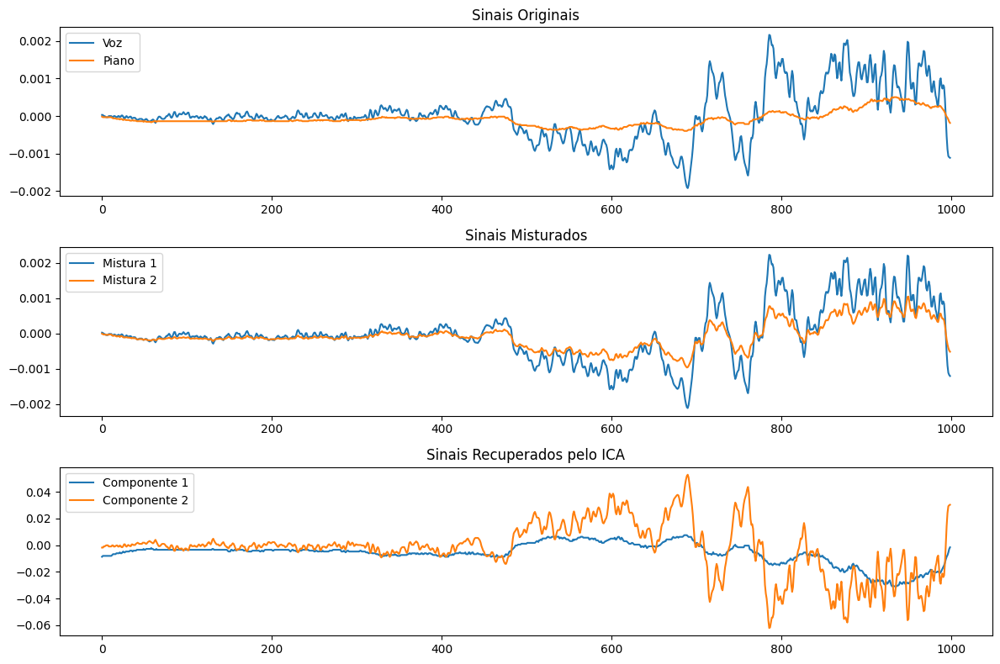

In [58]:
# Plotar os resultados — amostras pequenas, porque áudio é longo!
plt.figure(figsize=(12, 8))

plt.subplot(3, 1, 1)
plt.title('Sinais Originais')
plt.plot(S[:1000, 0], label='Voz') # S = matriz de sinais originais
plt.plot(S[:1000, 1], label='Piano')
plt.legend()

plt.subplot(3, 1, 2)
plt.title('Sinais Misturados')
plt.plot(X[:1000, 0], label='Mistura 1') # X = matriz de sinais misturados
plt.plot(X[:1000, 1], label='Mistura 2')
plt.legend()

plt.subplot(3, 1, 3)
plt.title('Sinais Recuperados pelo ICA')
plt.plot(S_estimated[:1000, 0], label='Componente 1') # S_estimated = matriz X após a plicação do ICA para extrair os dois componentes independentes
plt.plot(S_estimated[:1000, 1], label='Componente 2')
plt.legend()

plt.tight_layout()
plt.show()


*PASSO 6: Escutar os áudios de cada passo do problema*

*Áudios originais*

In [59]:
from IPython.display import Audio

Audio(S[:,0], rate=sr_voz) 

In [60]:
Audio(S[:,1], rate=sr_voz) 

*Áudios misturados com porcentagens diferentes de voz e piano*

In [66]:
Audio(X[:,0], rate=sr_voz) 

In [62]:
Audio(X[:,1], rate=sr_voz) 

*Áudios das duas componentes independentes resgatadas com ICA*

In [63]:
Audio(S_estimated[:,0], rate=sr_voz)

In [64]:
Audio(S_estimated[:,1], rate=sr_voz)